<a href="https://colab.research.google.com/github/Adi21032004/DeepFakeGenerator/blob/main/GAN_Generative_A_I.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# importing the libraries
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  ## optional
  if (wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

### hyperparameters and general parameters
n_epochs=10000
batch_size=128
lr=1e-4
z_dim=200
device='cuda' #GPU

cur_step=0
crit_cycles=5
gen_losses=[]
crit_losses=[]
show_step=35
save_step=35

wandbact=1


In [2]:
#### optional
!pip install wandb -qqq
import wandb
wandb.login(key='9ba7059e87e3935e02182a34fa7c4f29edf36a5e')

wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: nonglenadi (nonglenadi-iit-guwahati) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [3]:
%%capture
experiment_name = wandb.util.generate_id()

myrun=wandb.init(
    project="wgan",
    group=experiment_name,
    config={
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"1000",
        "batch_size":128
    }
)

config=wandb.config

## Sometimes this call to the wandb service may fail or give problems.
## If needed, you can use the Runtime->Restart Runtime option in the menus
## to restart and try again. If you keep having issues, you may set wandbact=0
## to skip temporarily the remote stats. You would also
## need to set wandbactive to 0 within the training loop in
## show(fake, wandbactive=0, name='fake') and show(real, wandbactive=0, name='real').
## However, in general this should work with no problems (try a few times if you have issues)

In [4]:
class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim=z_dim

    self.gen = nn.Sequential(
            ## ConvTranspose2d: in_channels, out_channels, kernel_size, stride=1, padding=0
            ## Calculating new width and height: (n-1)*stride -2*padding +ks
            ## n = width or height
            ## ks = kernel size
            ## we begin with a 1x1 image with z_dim number of channels (200)
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), ## 4x4 (ch: 200, 512)
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1), ## 8x8 (ch: 512, 256)
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1), ## 16x16 (ch: 256, 128)
            #(n-1)*stride -2*padding +ks = (8-1)*2-2*1+4=16
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1), ## 32x32 (ch: 128, 64)
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1), ## 64x64 (ch: 64, 32)
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1), ## 128x128 (ch: 32, 3)
            nn.Tanh() ### produce result in the range from -1 to 1
    )


  def forward(self, noise):
    x=noise.view(len(noise), self.z_dim, 1, 1)  # 128 x 200 x 1 x 1
    return self.gen(x)


def gen_noise(num, z_dim, device='cuda'):
   return torch.randn(num, z_dim, device=device) # 128 x 200



In [5]:
## critic model

class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(
      # Conv2d: in_channels, out_channels, kernel_size, stride=1, padding=0
      ## New width and height: # (n+2*pad-ks)//stride +1
      nn.Conv2d(3, d_dim, 4, 2, 1), #(n+2*pad-ks)//stride +1 = (128+2*1-4)//2+1=64x64 (ch: 3,16)
      nn.InstanceNorm2d(d_dim),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), ## 32x32 (ch: 16, 32)
      nn.InstanceNorm2d(d_dim*2),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), ## 16x16 (ch: 32, 64)
      nn.InstanceNorm2d(d_dim*4),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), ## 8x8 (ch: 64, 128)
      nn.InstanceNorm2d(d_dim*8),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), ## 4x4 (ch: 128, 256)
      nn.InstanceNorm2d(d_dim*16),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*16, 1, 4, 1, 0), #(n+2*pad-ks)//stride +1=(4+2*0-4)//1+1= 1X1 (ch: 256,1)

    )


  def forward(self, image):
    # image: 128 x 3 x 128 x 128
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred),-1) ## 128 x 1


In [6]:
## optional, init your weights in different ways
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)

    if isinstance(m,nn.BatchNorm2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)


##gen=gen.apply(init_weights)
##crit=crit.apply(init_weights)




In [7]:
from google.colab import files
files.upload()  # Choose kaggle.json when prompted

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"nonglenadityasingha","key":"013ceddcf6b63d09e56b6b291b04839b"}'}

In [8]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [9]:
# load dataset
import os
import zipfile

# Install kaggle if not already installed
!pip install -q kaggle

# Set up Kaggle API key
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# Create data path
path = 'data/celeba'
os.makedirs(path, exist_ok=True)

# Download and unzip using Kaggle CLI
!kaggle datasets download -d jessicali9530/celeba-dataset -p {path}
!unzip -q {path}/celeba-dataset.zip -d {path}



Dataset URL: https://www.kaggle.com/datasets/jessicali9530/celeba-dataset
License(s): other
 99% 1.31G/1.33G [00:06<00:00, 176MB/s]
100% 1.33G/1.33G [00:07<00:00, 179MB/s]


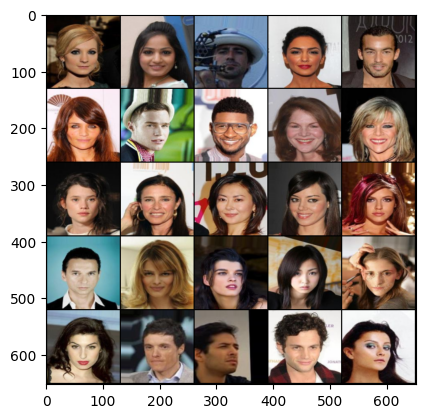

In [13]:
### Dataset, DataLoader, declare gen,crit, test dataset

class Dat(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path)[:lim]:
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]

## Dataset
data_path='./data/celeba/img_align_celeba/img_align_celeba'
ds = Dat(data_path, size=128, lim=10000)

## DataLoader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

## Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

## Initializations
##gen=gen.apply(init_weights)
##crit=crit.apply(init_weights)

if (wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x,y=next(iter(dataloader))
show(x)


In [14]:
## gradient penalty calculation

def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128 x 3 x 128 x 128
  mix_scores = crit(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1)   # 128 x 49152
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm-1)**2).mean()

  return gp



In [15]:
## Save and load checkpoints

root_path='./data/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G-{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C-{name}.pkl")

  print("Saved checkpoint")

def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded checkpoint")

#load_checkpoint('final-wgan-noinit')

In [ ]:
#!cp C-final* ./data/
#!cp G-final* ./data/
#epoch=1
#save_checkpoint("test")
#load_checkpoint("test")


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  35 35
Saved checkpoint


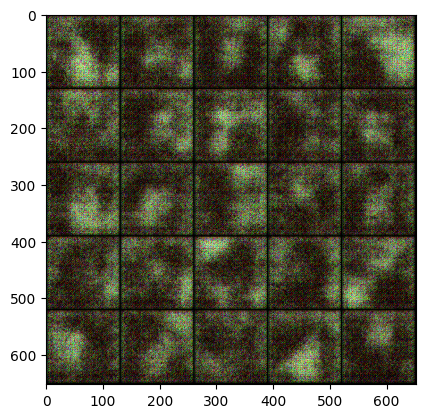

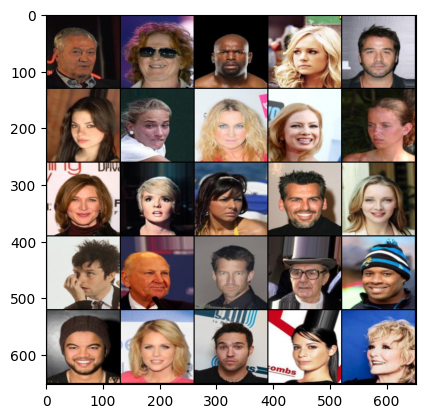

Epoch: 0: Step 35: Generator loss: 9.728241917703834, critic loss: -8.157201933520179


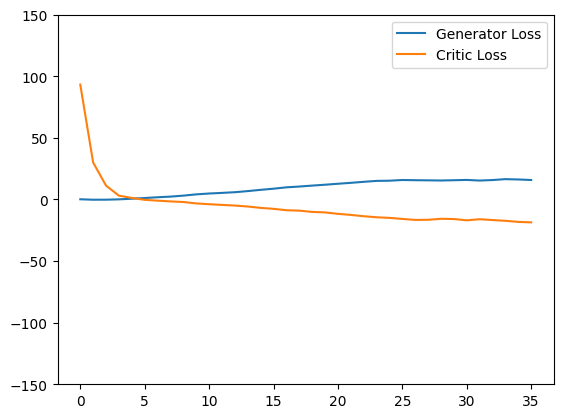

Saving checkpoint:  70 35
Saved checkpoint


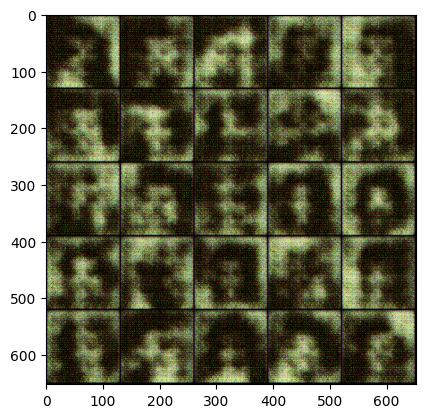

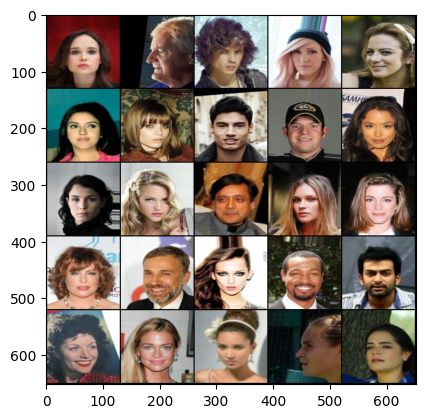

Epoch: 0: Step 70: Generator loss: 20.922695922851563, critic loss: -22.05383340018136


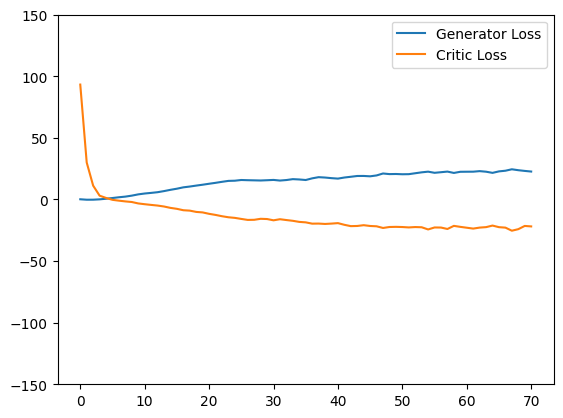

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  105 35
Saved checkpoint


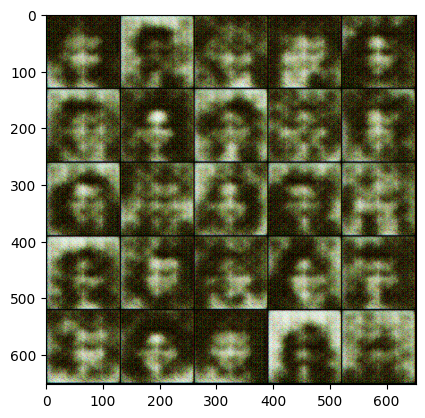

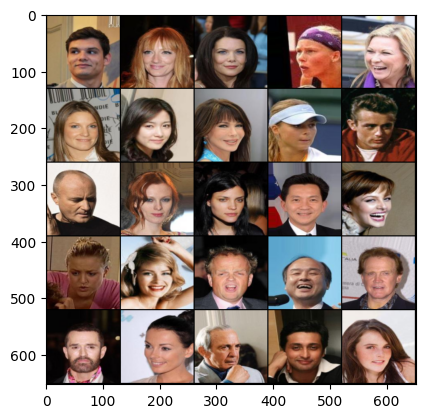

Epoch: 1: Step 105: Generator loss: 25.901965277535574, critic loss: -25.722902494158063


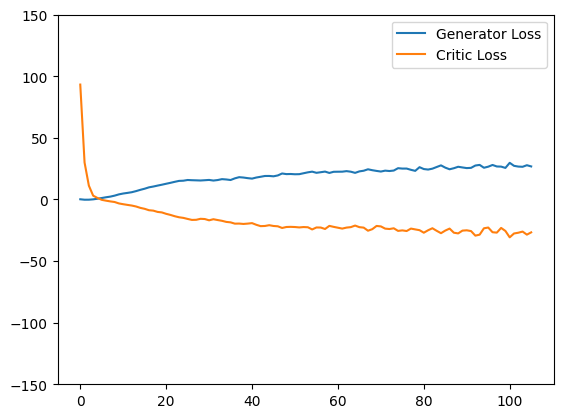

Saving checkpoint:  140 35
Saved checkpoint


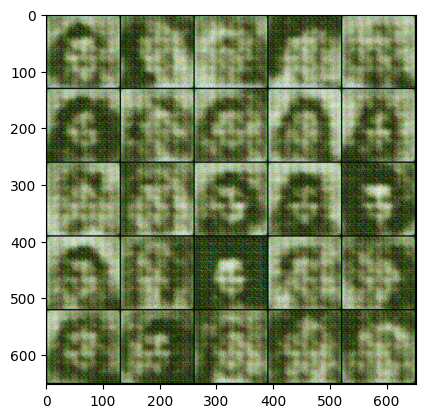

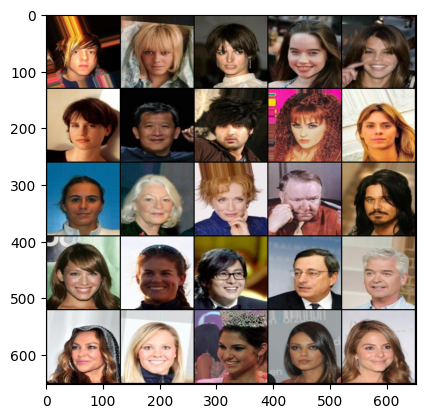

Epoch: 1: Step 140: Generator loss: 23.946920939854213, critic loss: -23.448439014979762


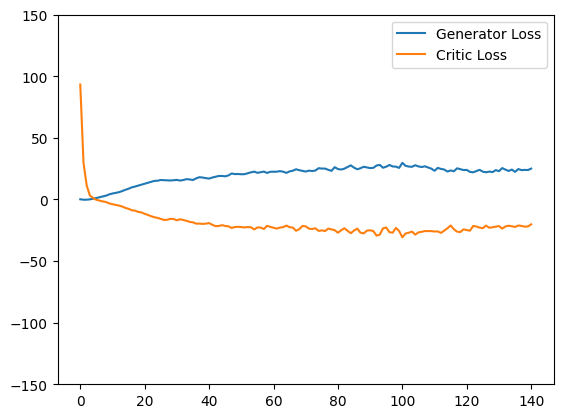

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  175 35
Saved checkpoint


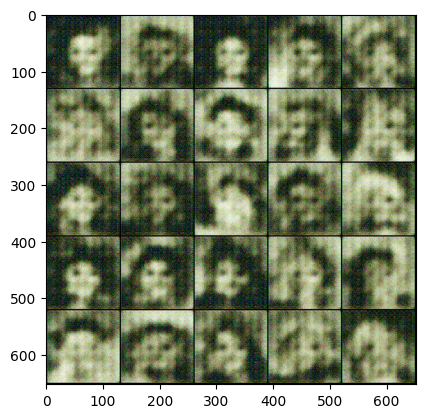

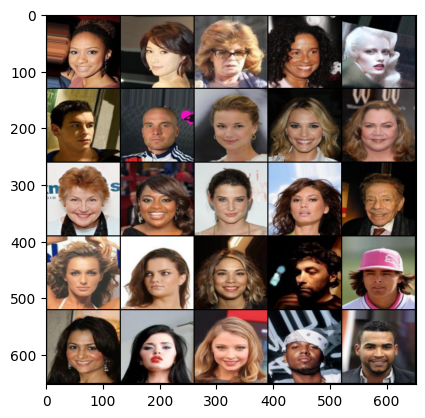

Epoch: 2: Step 175: Generator loss: 24.21750455583845, critic loss: -18.831497028895793


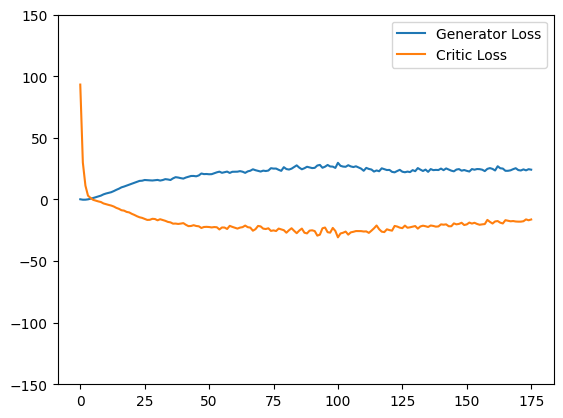

Saving checkpoint:  210 35
Saved checkpoint


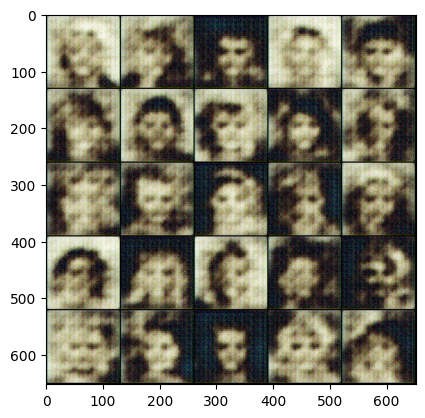

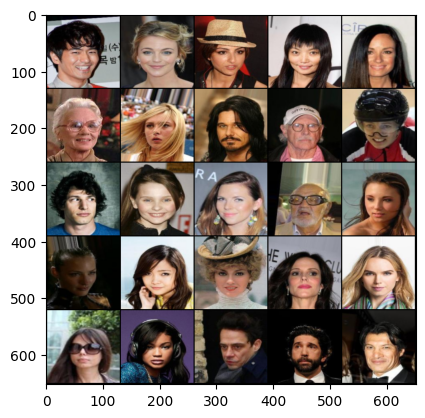

Epoch: 2: Step 210: Generator loss: 24.198109218052455, critic loss: -16.372630440848216


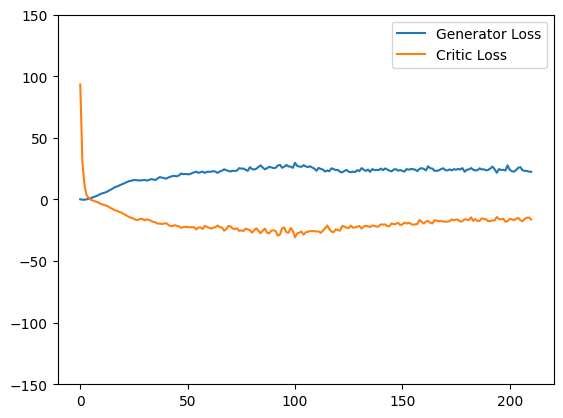

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  245 35
Saved checkpoint


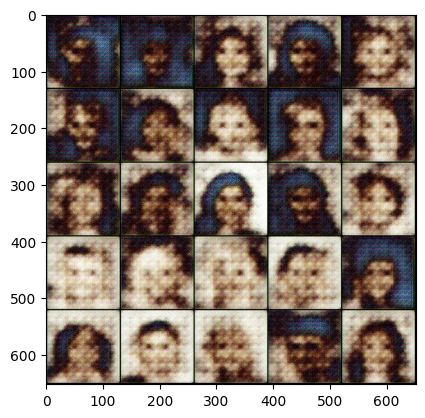

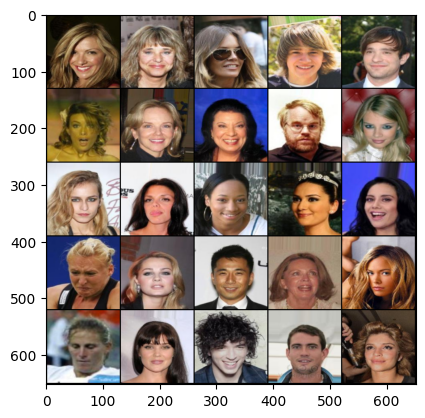

Epoch: 3: Step 245: Generator loss: 22.81547611781529, critic loss: -15.621589911324639


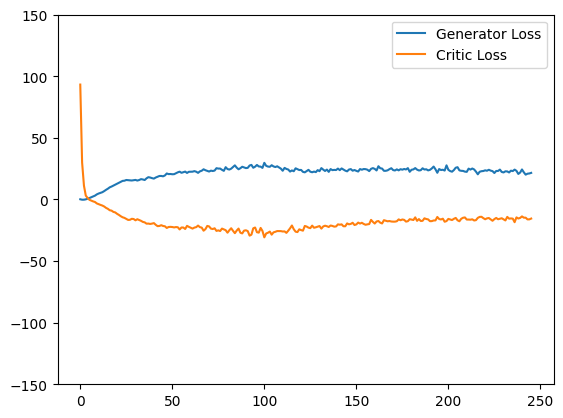

Saving checkpoint:  280 35
Saved checkpoint


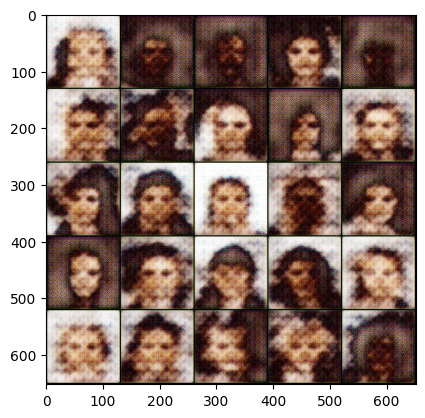

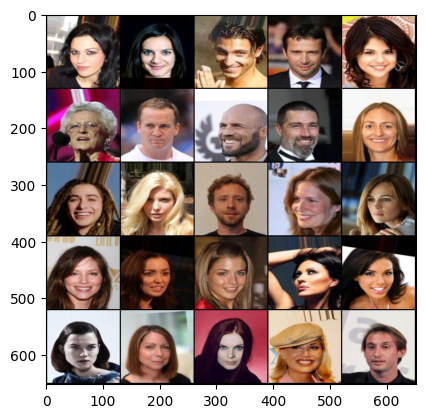

Epoch: 3: Step 280: Generator loss: 22.972360937935964, critic loss: -14.667050813947405


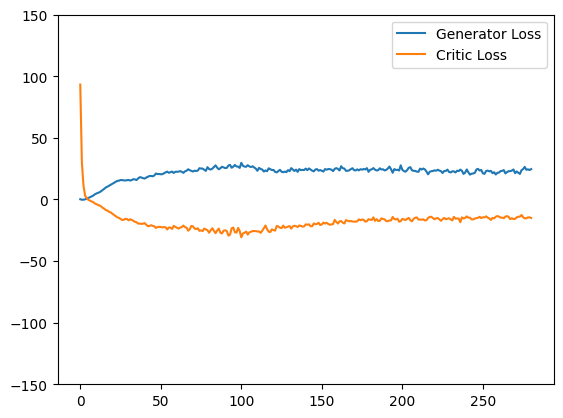

Saving checkpoint:  315 35
Saved checkpoint


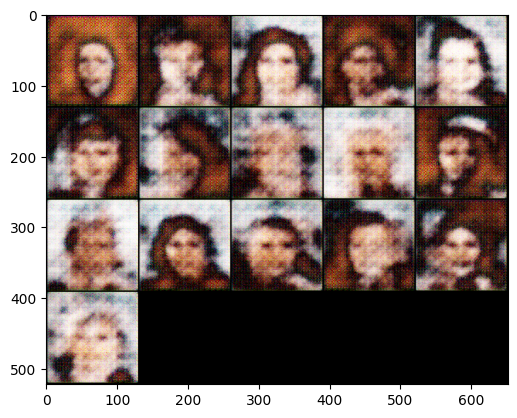

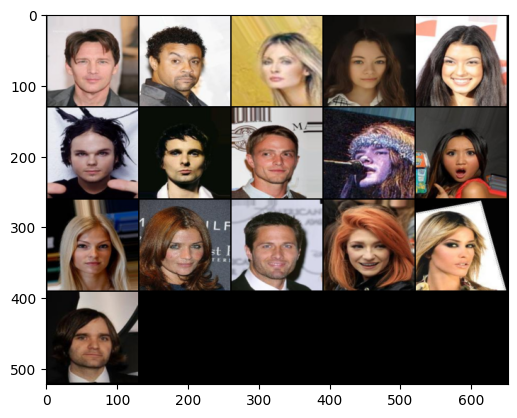

Epoch: 3: Step 315: Generator loss: 23.996622739519392, critic loss: -14.614111012050081


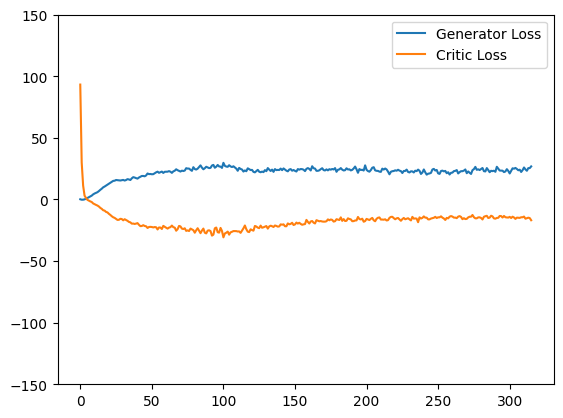

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  350 35
Saved checkpoint


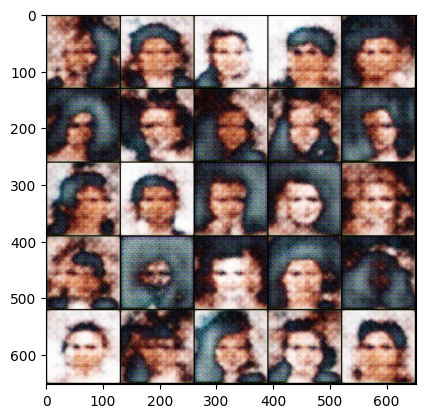

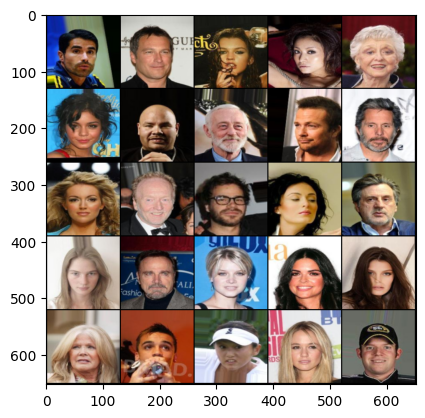

Epoch: 4: Step 350: Generator loss: 23.88472785949707, critic loss: -13.95142454964774


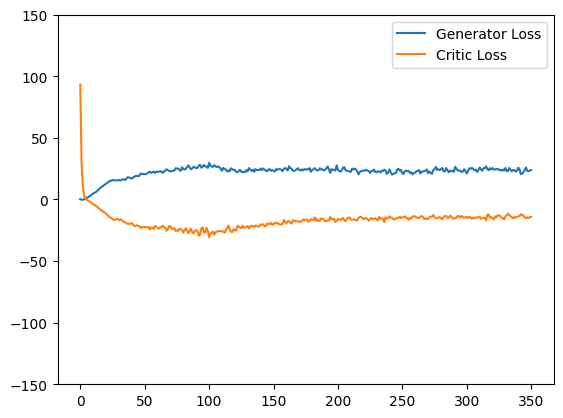

Saving checkpoint:  385 35
Saved checkpoint


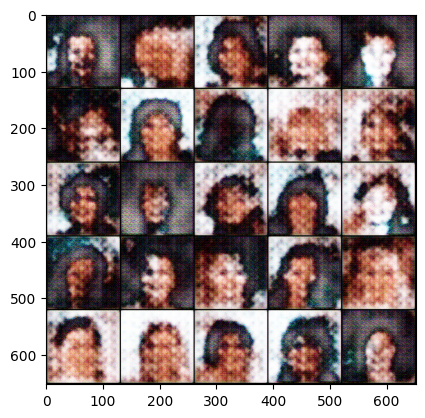

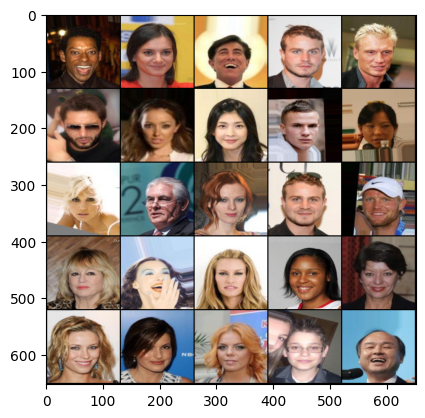

Epoch: 4: Step 385: Generator loss: 23.421188735961913, critic loss: -13.500834999084473


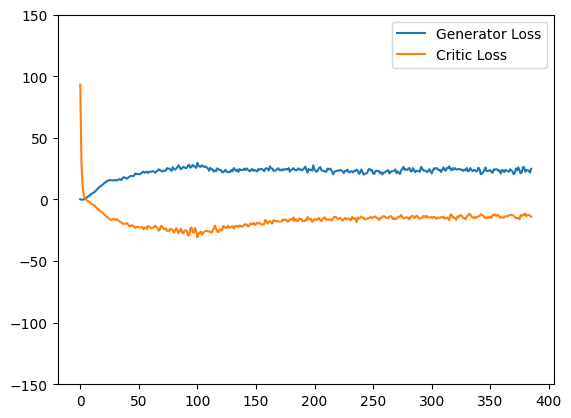

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  420 35
Saved checkpoint


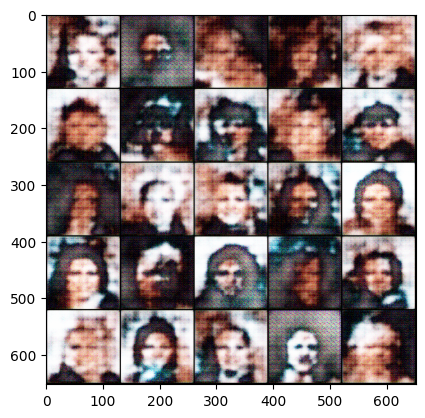

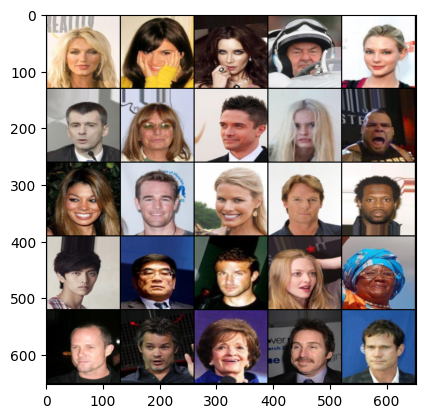

Epoch: 5: Step 420: Generator loss: 23.53646501813616, critic loss: -12.815345856802804


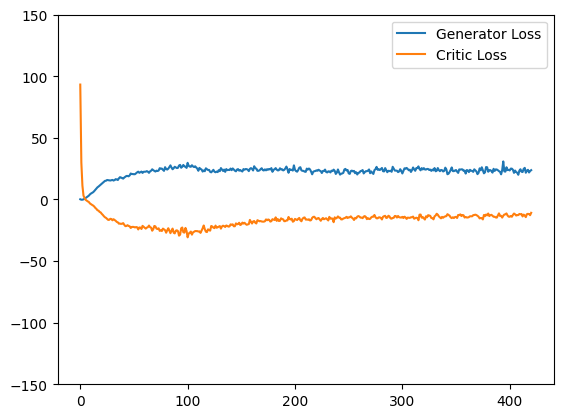

Saving checkpoint:  455 35
Saved checkpoint


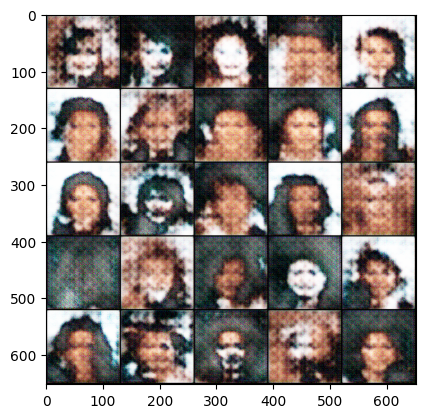

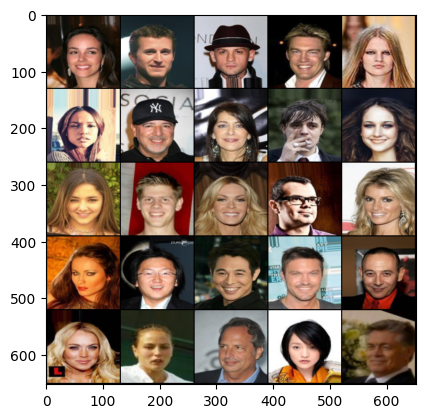

Epoch: 5: Step 455: Generator loss: 23.197026279994418, critic loss: -12.16670127868652


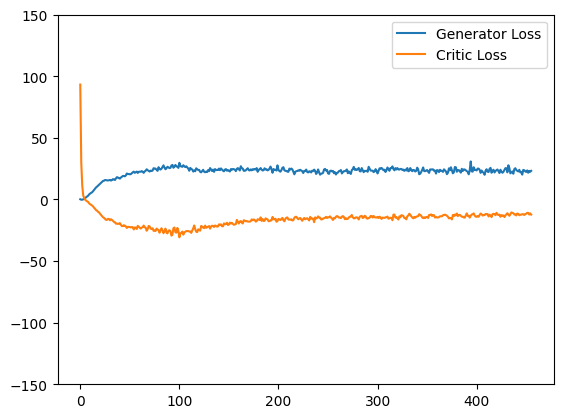

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  490 35
Saved checkpoint


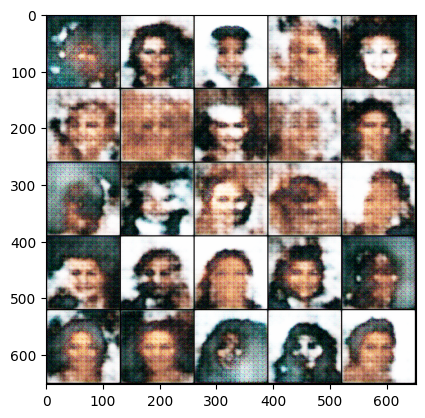

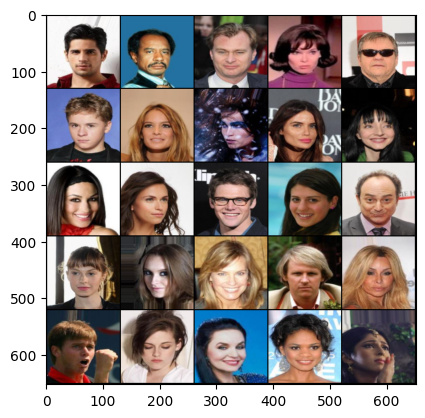

Epoch: 6: Step 490: Generator loss: 22.98040678841727, critic loss: -11.586763346535816


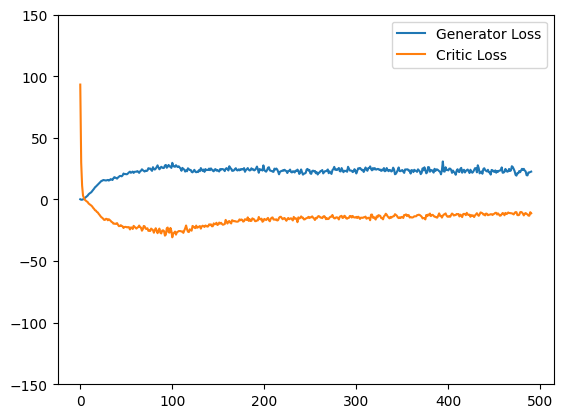

Saving checkpoint:  525 35
Saved checkpoint


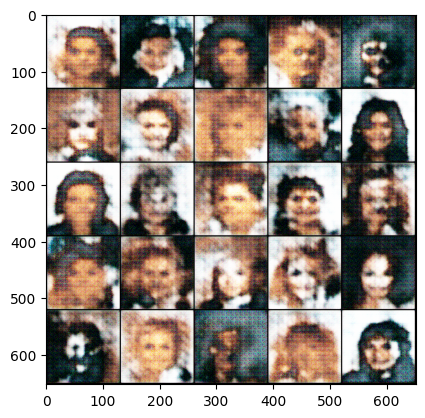

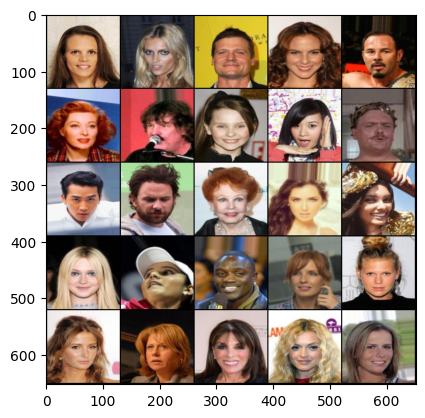

Epoch: 6: Step 525: Generator loss: 22.586761256626673, critic loss: -11.206349152156283


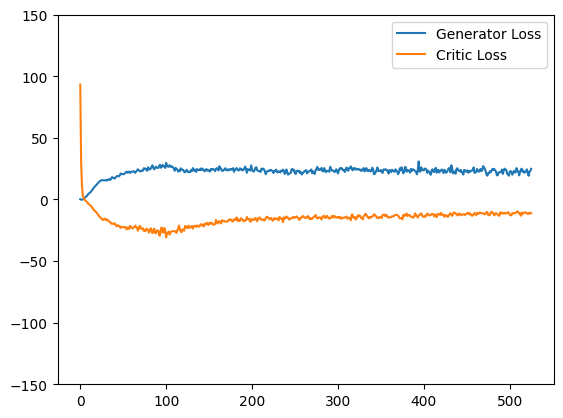

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 35
Saved checkpoint


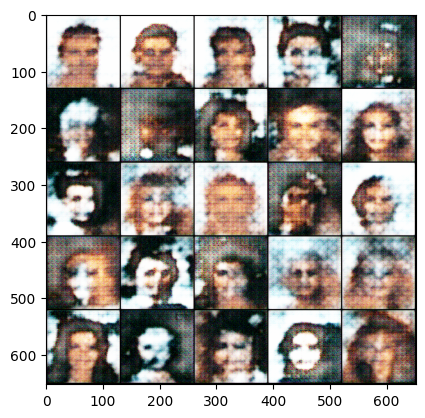

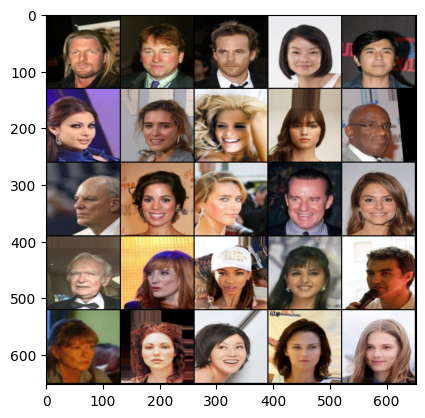

Epoch: 7: Step 560: Generator loss: 22.2653439113072, critic loss: -10.730505213056292


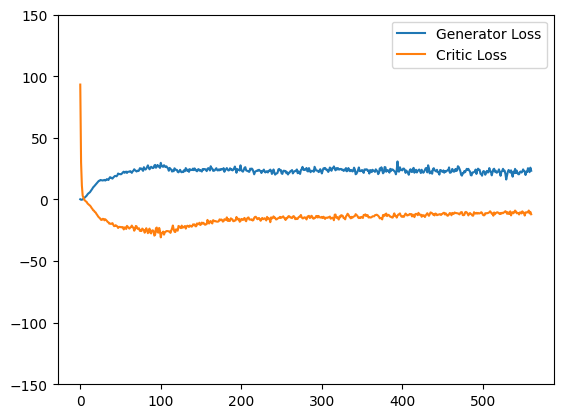

Saving checkpoint:  595 35
Saved checkpoint


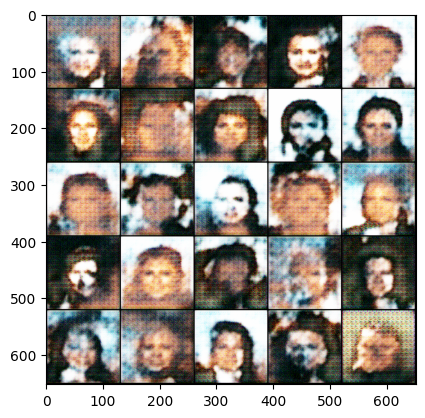

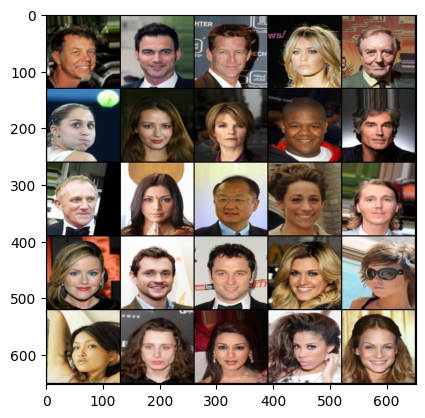

Epoch: 7: Step 595: Generator loss: 21.55080920628139, critic loss: -10.260306044987269


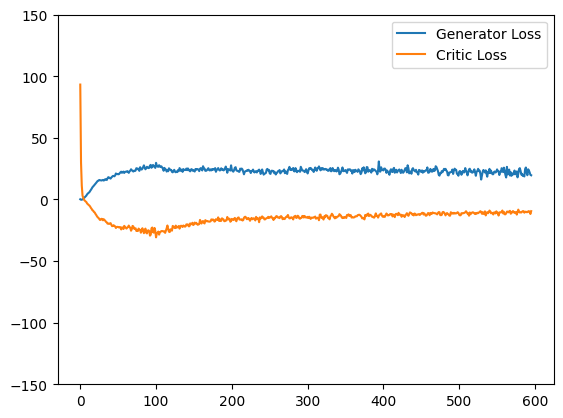

Saving checkpoint:  630 35
Saved checkpoint


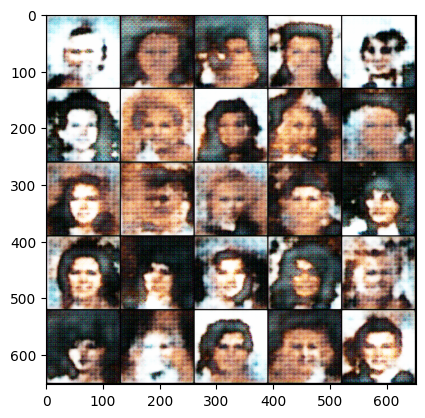

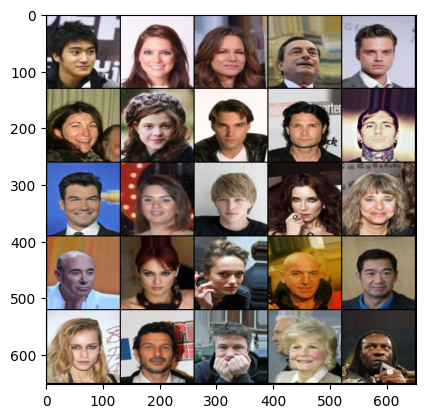

Epoch: 7: Step 630: Generator loss: 21.453280203683036, critic loss: -9.94372731072562


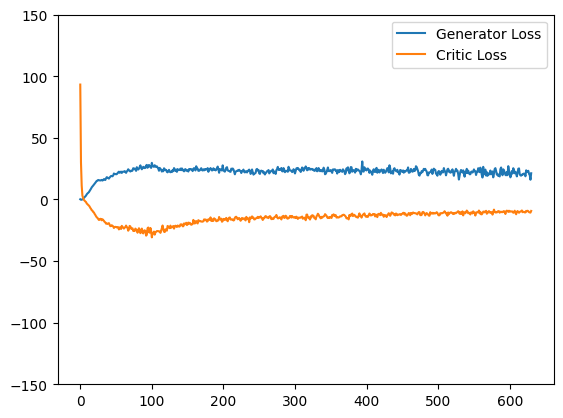

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  665 35
Saved checkpoint


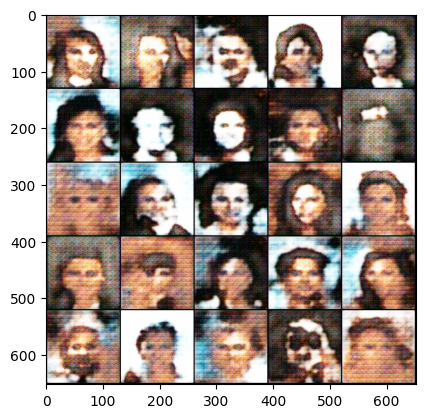

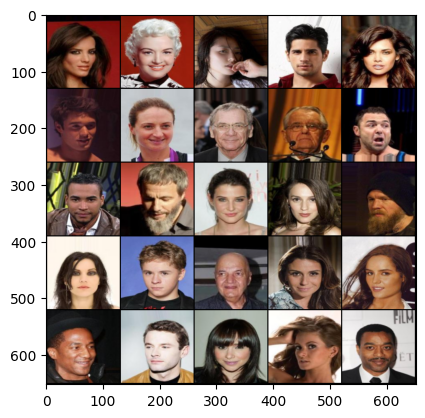

Epoch: 8: Step 665: Generator loss: 22.61862357003348, critic loss: -10.026515009743827


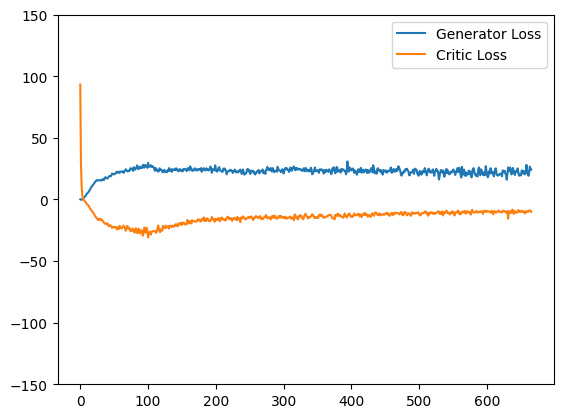

Saving checkpoint:  700 35
Saved checkpoint


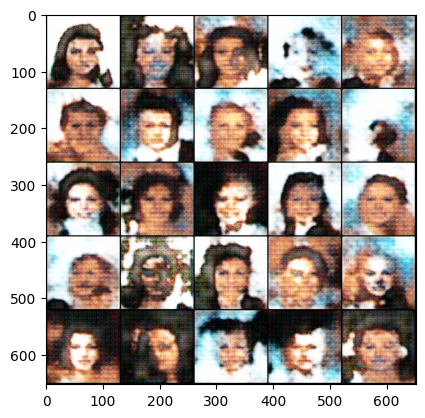

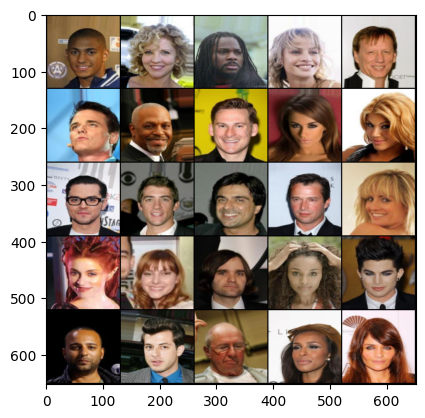

Epoch: 8: Step 700: Generator loss: 22.34551762172154, critic loss: -9.74224622998919


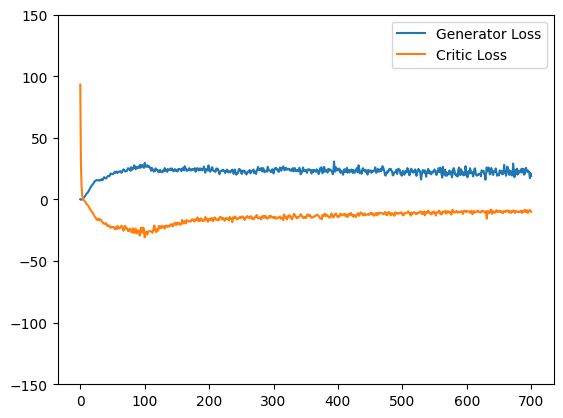

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  735 35
Saved checkpoint


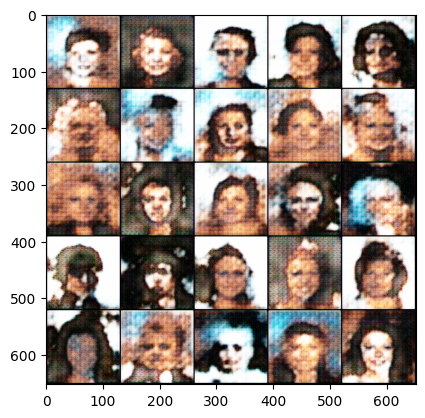

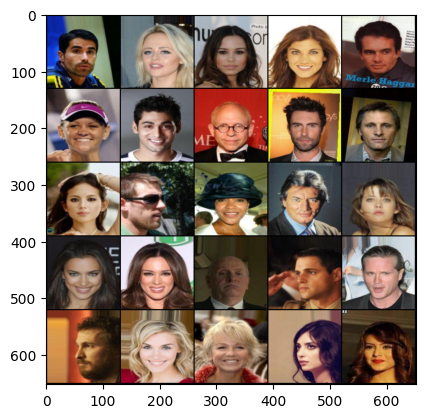

Epoch: 9: Step 735: Generator loss: 23.380021013532367, critic loss: -9.560964734213695


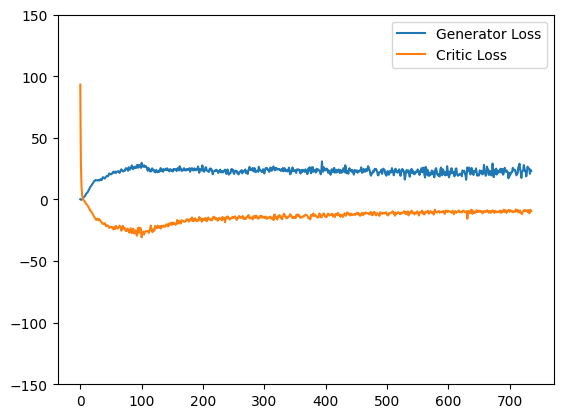

Saving checkpoint:  770 35
Saved checkpoint


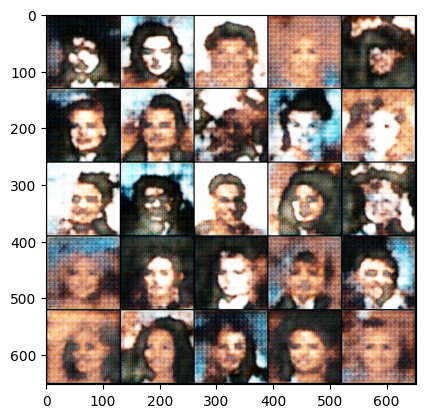

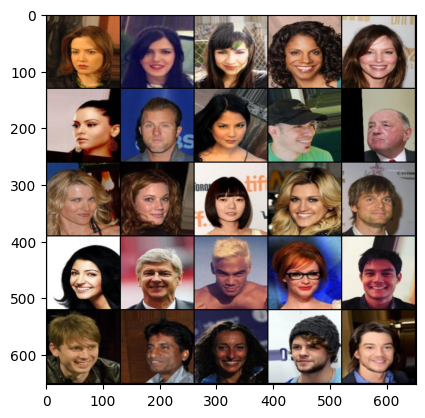

Epoch: 9: Step 770: Generator loss: 23.708677346365793, critic loss: -9.304203597477505


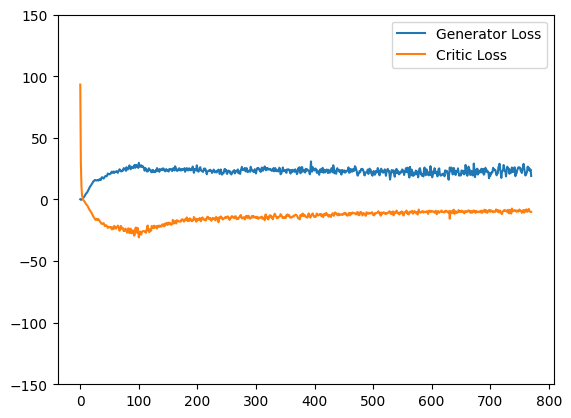

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  805 35
Saved checkpoint


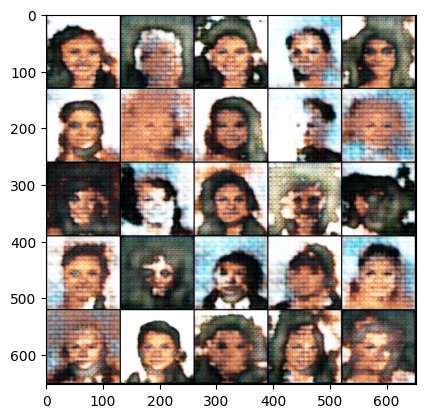

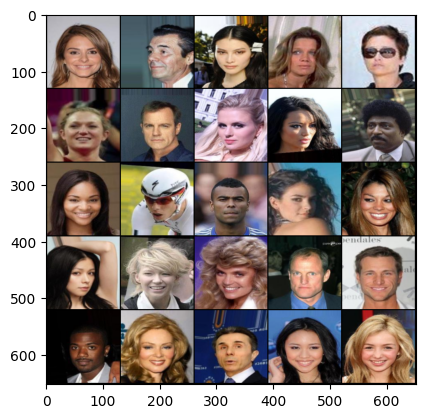

Epoch: 10: Step 805: Generator loss: 23.52294180733817, critic loss: -9.27438909803118


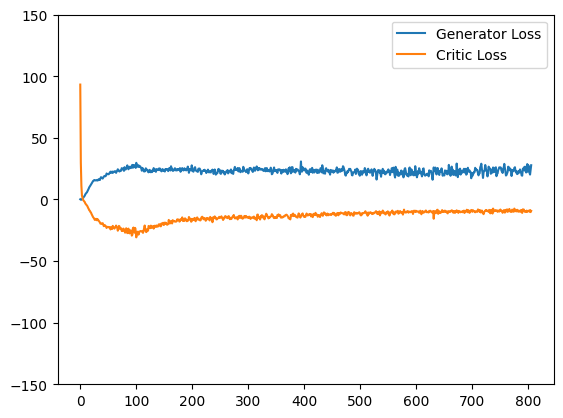

Saving checkpoint:  840 35
Saved checkpoint


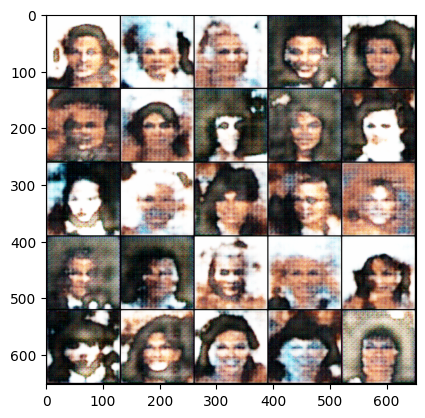

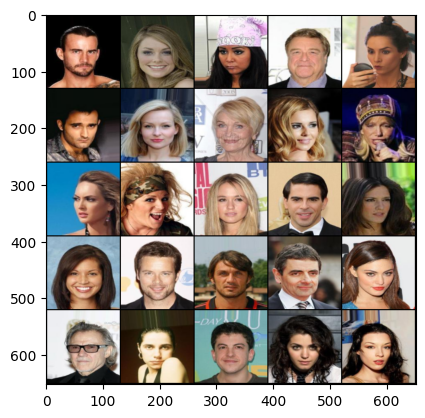

Epoch: 10: Step 840: Generator loss: 24.22142094203404, critic loss: -9.06947212082999


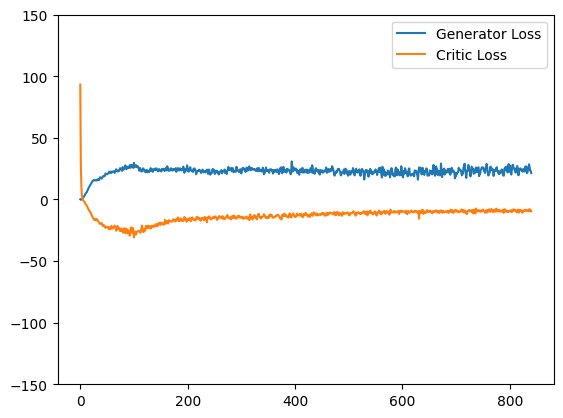

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  875 35
Saved checkpoint


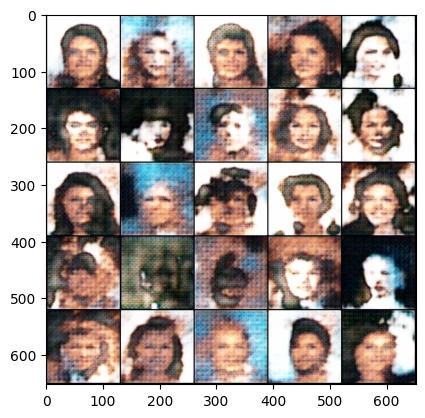

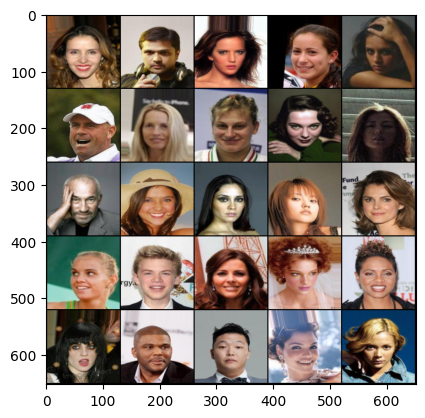

Epoch: 11: Step 875: Generator loss: 23.827761895315987, critic loss: -8.917217647007533


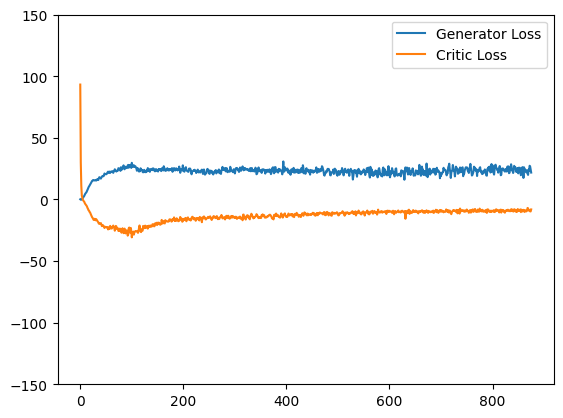

Saving checkpoint:  910 35
Saved checkpoint


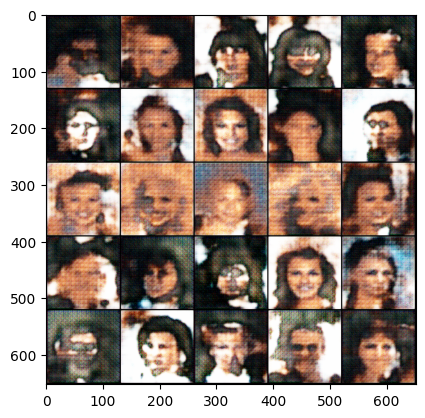

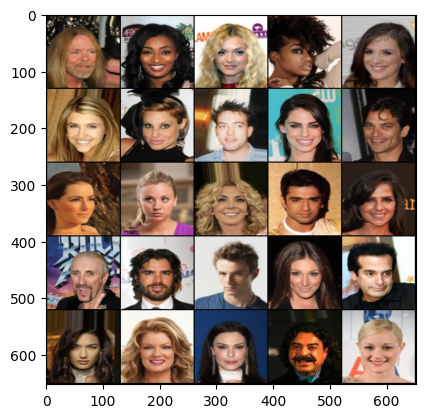

Epoch: 11: Step 910: Generator loss: 23.567683247157504, critic loss: -9.0321643611363


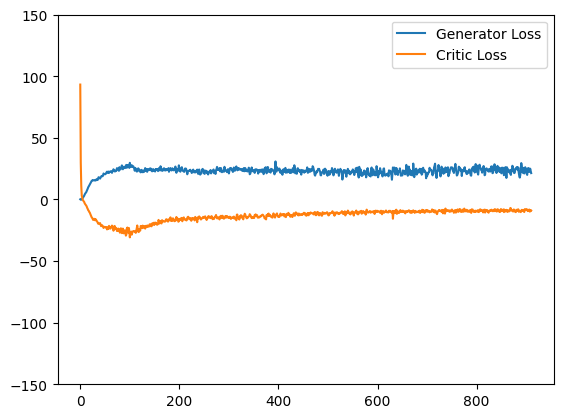

Saving checkpoint:  945 35
Saved checkpoint


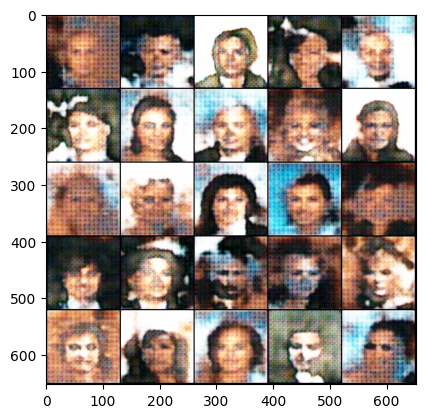

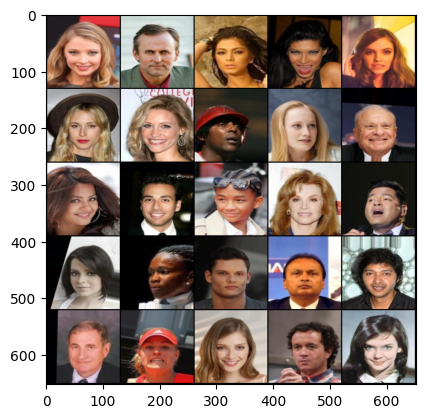

Epoch: 11: Step 945: Generator loss: 24.38032433646066, critic loss: -8.990461744580948


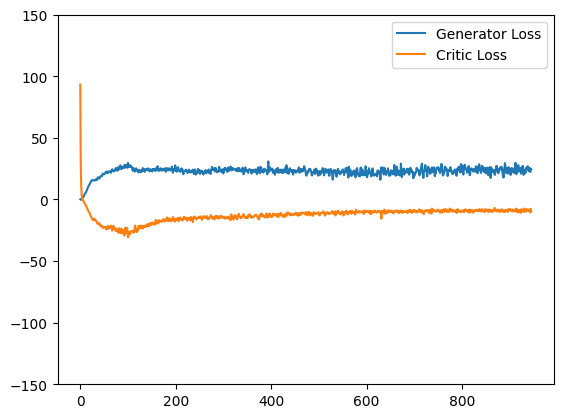

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  980 35
Saved checkpoint


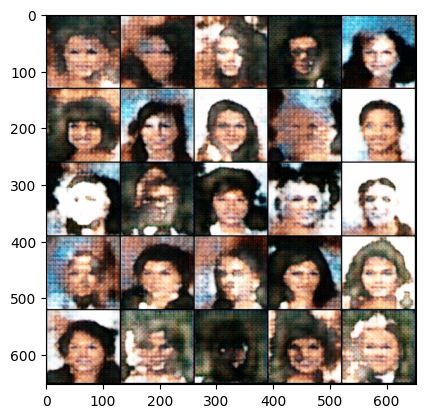

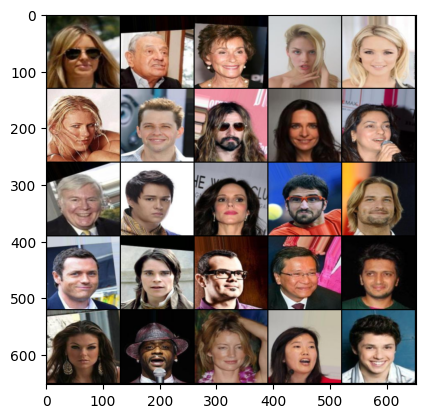

Epoch: 12: Step 980: Generator loss: 24.118968037196566, critic loss: -8.797312169756209


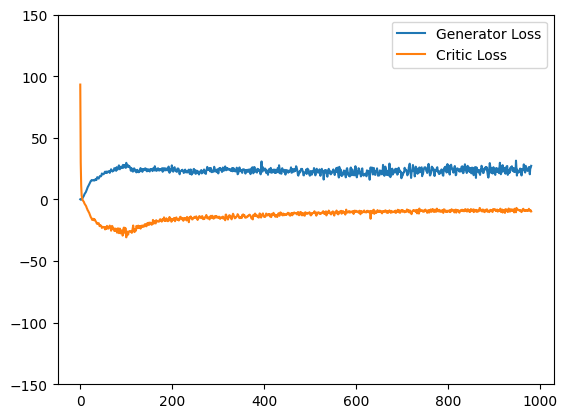

Saving checkpoint:  1015 35
Saved checkpoint


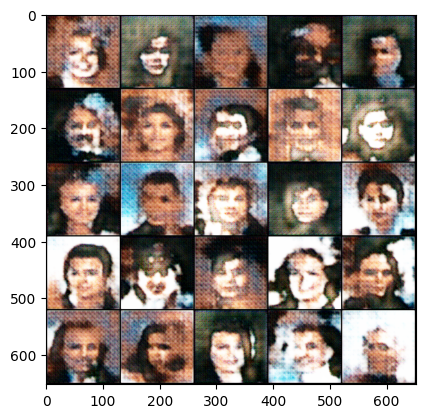

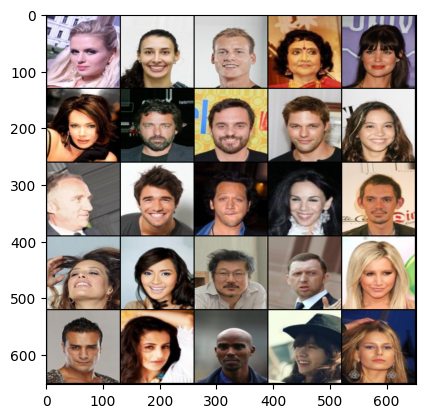

Epoch: 12: Step 1015: Generator loss: 23.756786237444196, critic loss: -8.6909849357605


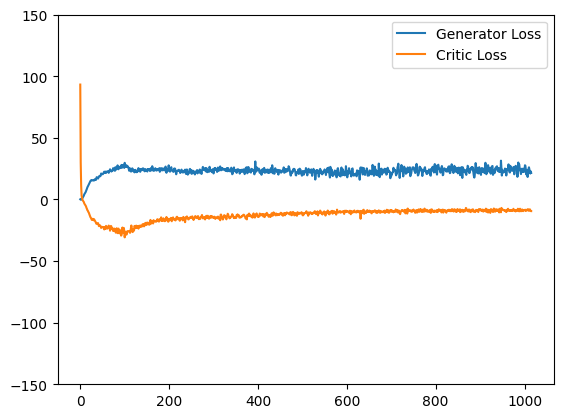

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1050 35
Saved checkpoint


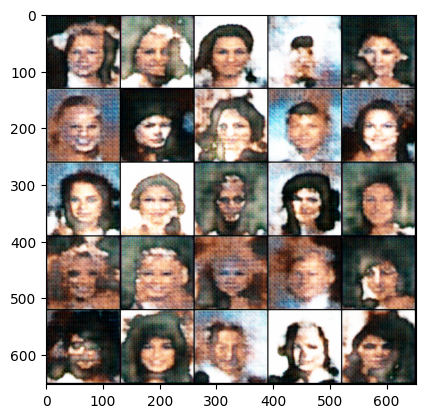

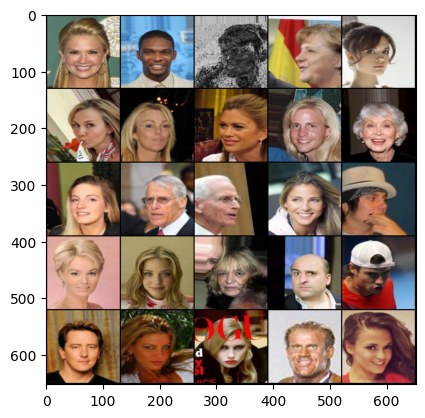

Epoch: 13: Step 1050: Generator loss: 24.27205957685198, critic loss: -8.375046787261963


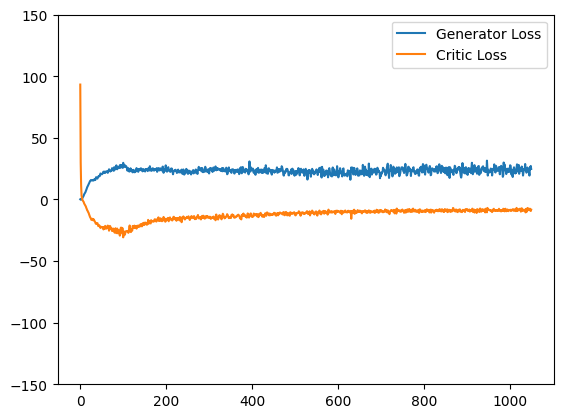

Saving checkpoint:  1085 35
Saved checkpoint


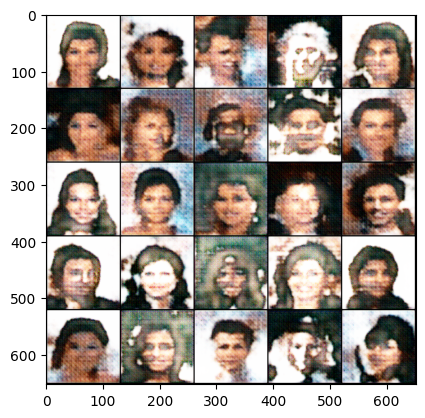

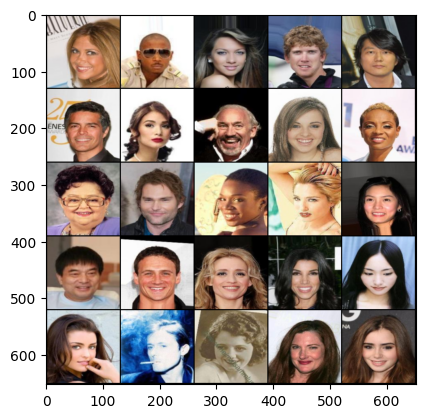

Epoch: 13: Step 1085: Generator loss: 24.096324484688896, critic loss: -8.413971146174836


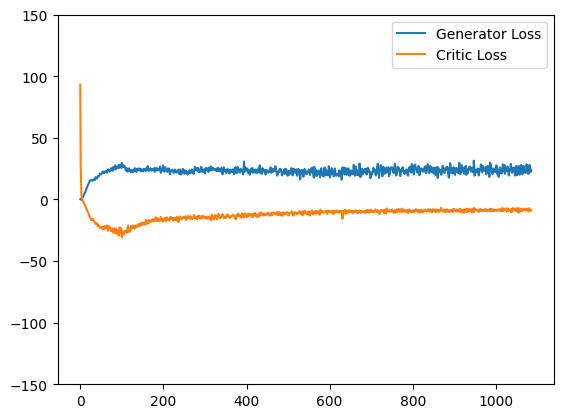

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1120 35
Saved checkpoint


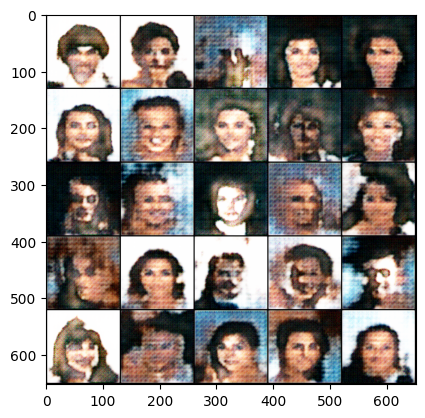

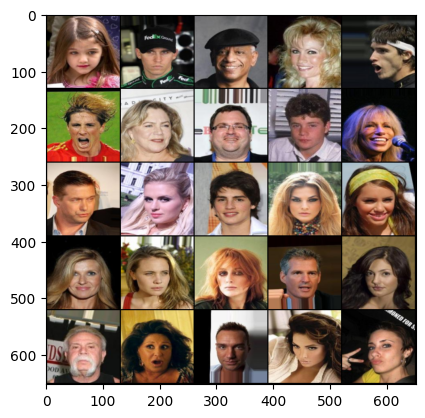

Epoch: 14: Step 1120: Generator loss: 24.26704172406878, critic loss: -8.123920933859688


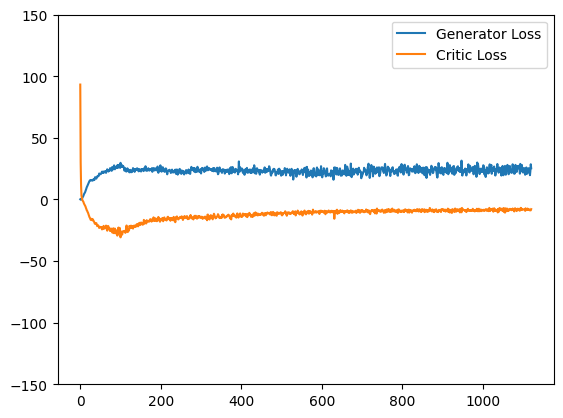

Saving checkpoint:  1155 35
Saved checkpoint


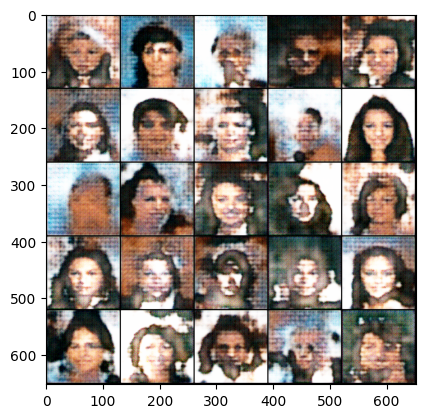

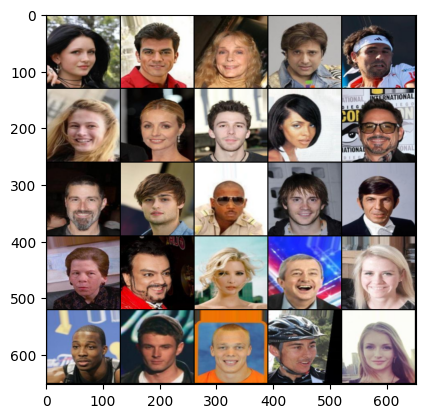

Epoch: 14: Step 1155: Generator loss: 24.569482476370677, critic loss: -8.419122676849364


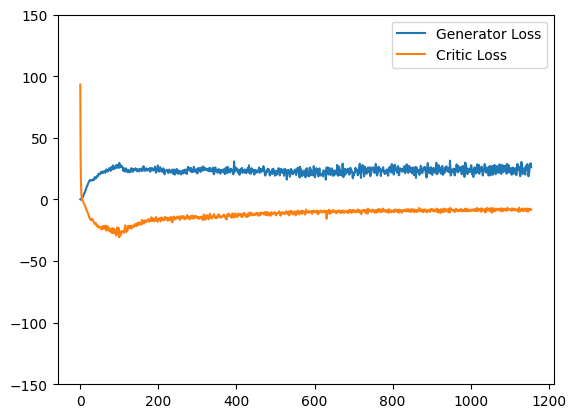

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1190 35
Saved checkpoint


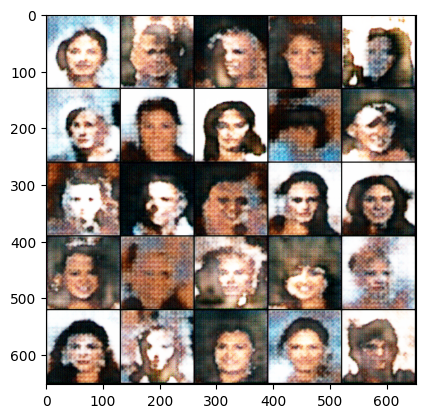

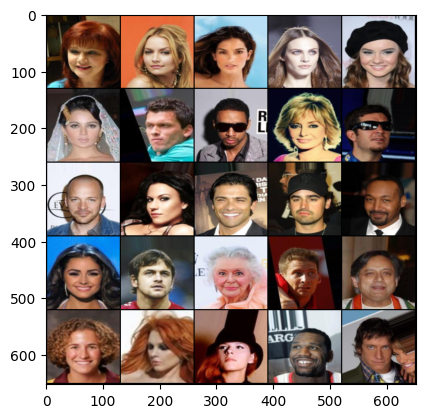

Epoch: 15: Step 1190: Generator loss: 24.118593406677245, critic loss: -8.365811459677557


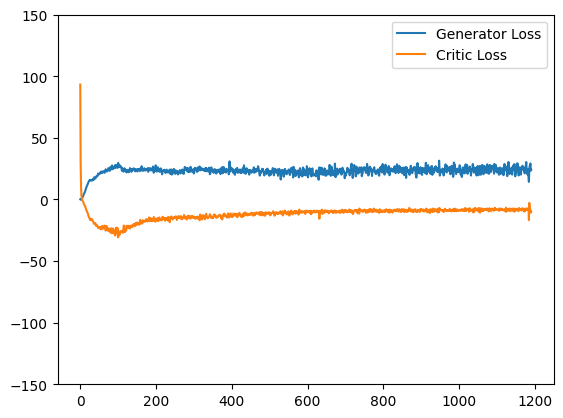

Saving checkpoint:  1225 35
Saved checkpoint


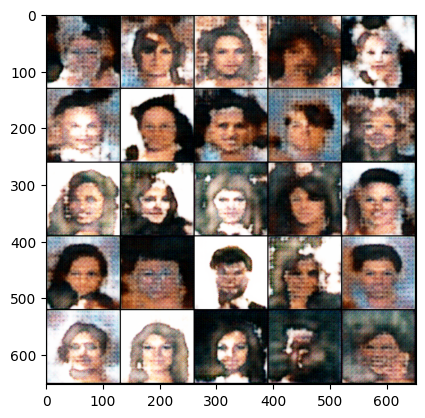

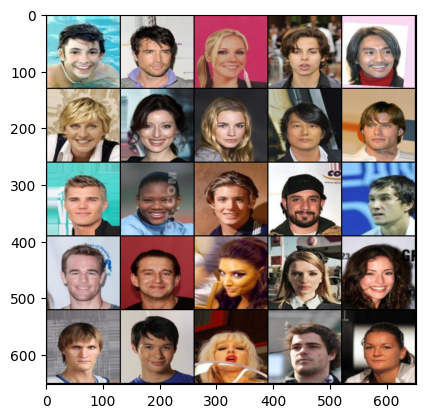

Epoch: 15: Step 1225: Generator loss: 24.391458565848215, critic loss: -8.182891874313356


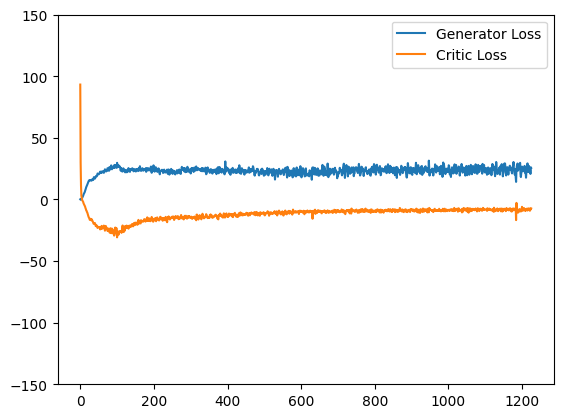

Saving checkpoint:  1260 35
Saved checkpoint


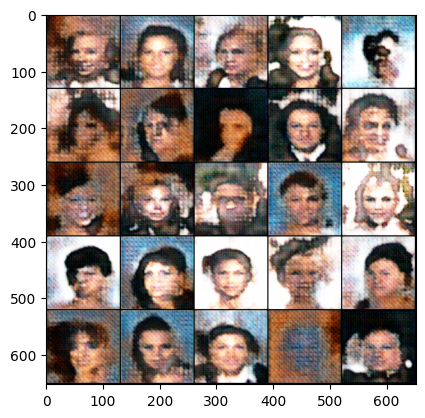

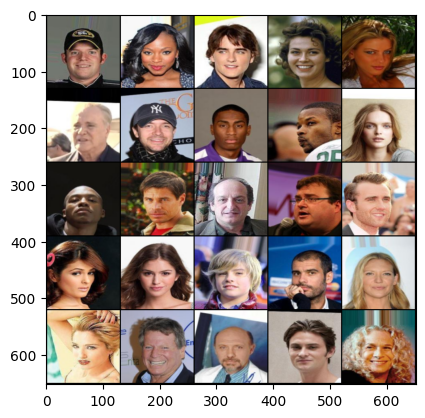

Epoch: 15: Step 1260: Generator loss: 23.51950362069266, critic loss: -8.030145440782821


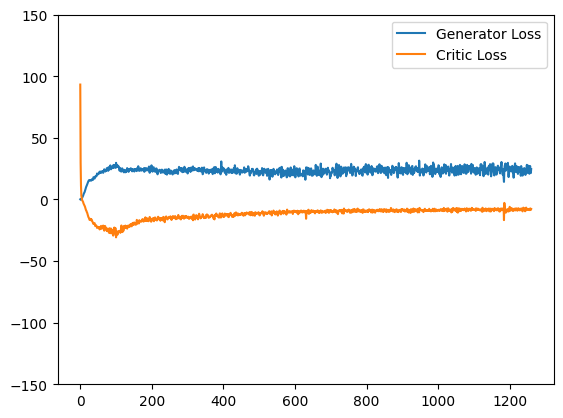

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1295 35
Saved checkpoint


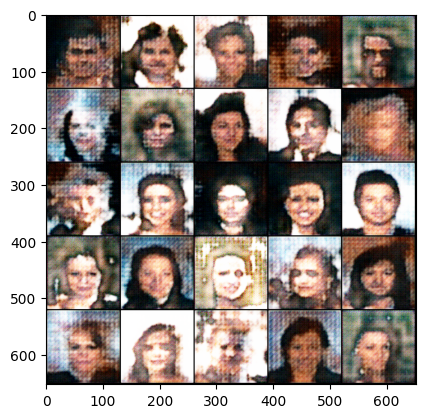

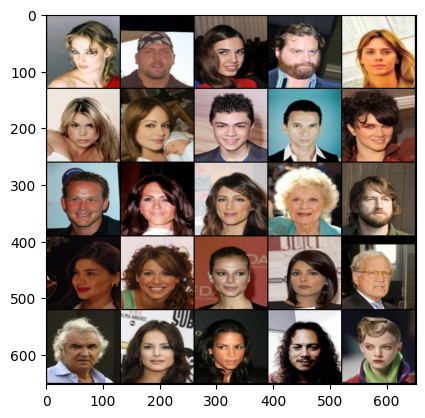

Epoch: 16: Step 1295: Generator loss: 24.130154745919363, critic loss: -8.206181216921124


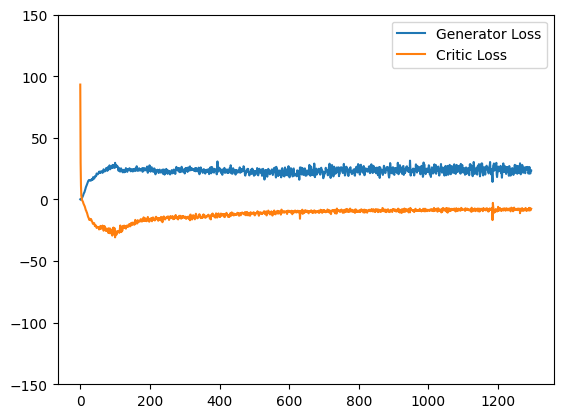

In [ ]:
## Training loop

for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs= len(real) #128
    real=real.to(device)

    ### CRITIC
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise=gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss+=crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+=[mean_crit_loss]

    ### GENERATOR
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+=[gen_loss.item()]

    ### Stats

    if (wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss':mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoint: ", cur_step, save_step)
      save_checkpoint("latest")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean=sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label="Generator Loss"
      )

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(crit_losses),
          label="Critic Loss"
      )

      plt.ylim(-150,150)
      plt.legend()
      plt.show()

    cur_step+=1


In [ ]:
# number of steps per epoch
# 10000 / 128 = 78.125
# 50000 / 128 = 390.625

In [ ]:
#### Generate new faces
noise = gen_noise(batch_size, z_dim)
fake = gen(noise)
show(fake)

In [ ]:
plt.imshow(fake[16].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

In [ ]:
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()